#### Laboratorium 8 - zadania

Przeczytaj treść całej instrukcji przed przystąpieniem do działania!

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

#### Zadanie 1 (2.0 pkt | 1.0 pkt)

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na kilka kamieni milowych - czytaj dalej.

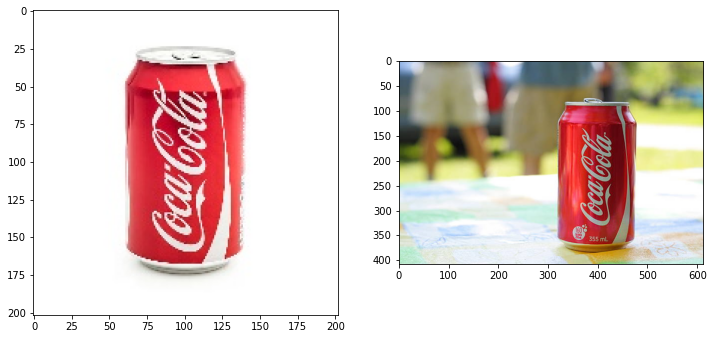

In [2]:
coke = cv2.imread('coke.jpg')
table = cv2.imread('coke-table.jpg')
f, (a1, a2) = plt.subplots(1, 2, figsize=(12,12))
a1.imshow(coke[..., ::-1]);
a2.imshow(table[..., ::-1]);

##### Zadanie 1a (0.25 pkt | 0.25 pkt)

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

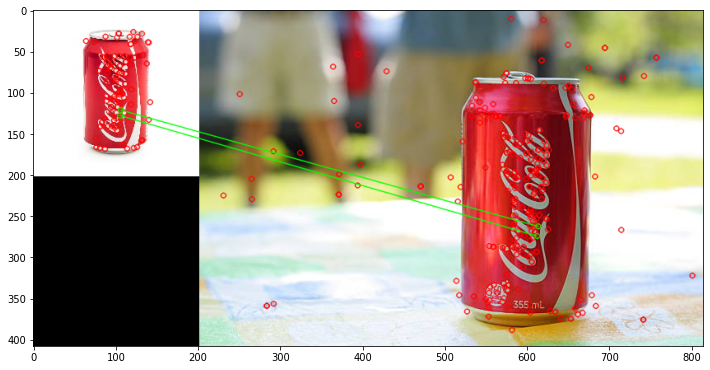

In [49]:
def detect_keypoints(img1, img2, dist_threshold=10):
    sift = cv2.SIFT_create(contrastThreshold=0.05)
    kp1, ds1 = sift.detectAndCompute(img1, mask=None)
    kp2, ds2 = sift.detectAndCompute(img2, mask=None)

    matcher = cv2.BFMatcher_create()
    best_matches = matcher.match(ds1, ds2)
    
    def check_threshold(match):
        if match.distance <= dist_threshold:
              return True  
        return False

    dist_iterator = filter(check_threshold, best_matches)
    
    show_matches = cv2.drawMatches(img1, kp1, img2, kp2, list(dist_iterator), None, matchColor=(0,255,0), singlePointColor=(0,0,255))
    plt.subplots(1, 1, figsize=(12,12))[1].imshow(show_matches[...,::-1]);
#     return show_matches[...,::-1]
    
    
    
cola1 = detect_keypoints(coke, table, 100)

In [9]:
cola2 = detect_keypoints(coke, table, 200)

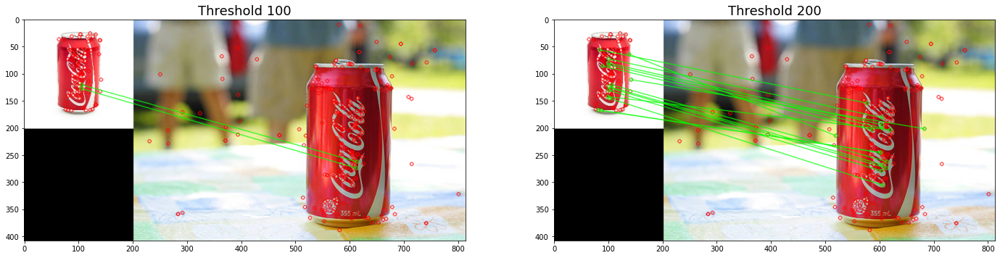

In [15]:
fig, ax = plt.subplots(1,2, figsize=(24,12))
ax[0].imshow(cola1)
ax[1].imshow(cola2)
ax[0].set_title('Threshold 100', fontsize=18);
ax[1].set_title('Threshold 200', fontsize=18);
plt.savefig('zad1v1.png')

##### Zadanie 1b (0.25 pkt | 0.25 pkt)

Powtórz detekcję z użyciem k-najlepszych wyników (dla niewielkiego k, np. 2 lub 3). Zaproponuj prosty sposób wykrywania sytuacji, w których jeden punkt jest podobnie bliski innym i użyj go do odfiltrowania wyników, tak aby pozostawić te bardziej unikatowe dopasowania. *Czy unikatowe znaczy dobre?*

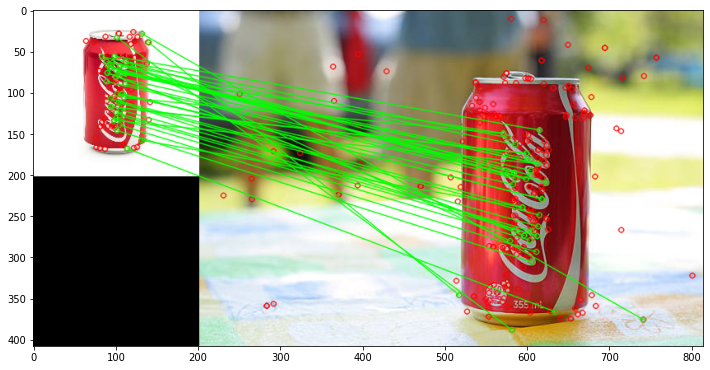

In [22]:
def detect_keypoints2(img1, img2, dist_scaler=5):
    sift = cv2.SIFT_create(contrastThreshold=0.05)
    kp1, ds1 = sift.detectAndCompute(img1, mask=None)
    kp2, ds2 = sift.detectAndCompute(img2, mask=None)

    matcher = cv2.BFMatcher_create()
    best_k_matches = matcher.knnMatch(ds1, ds2, k=3)
    
    best_matches = []
    i = 0
    for match in best_k_matches:
        m1, m2, m3 = match[0], match[1], match[2]
        first_diff = np.abs(m1.distance - m2.distance)
        second_diff = np.abs(m2.distance - m3.distance)
        
        if first_diff > second_diff * dist_scaler:
            best_matches.append(m1)
    
    show_matches = cv2.drawMatches(img1, kp1, img2, kp2, best_matches, None, matchColor=(0,255,0), singlePointColor=(0,0,255))
    plt.subplots(1, 1, figsize=(12,12))[1].imshow(show_matches[...,::-1]);
    
    
    
    
detect_keypoints2(coke, table, 5)
plt.savefig('zad1v2_1.png')

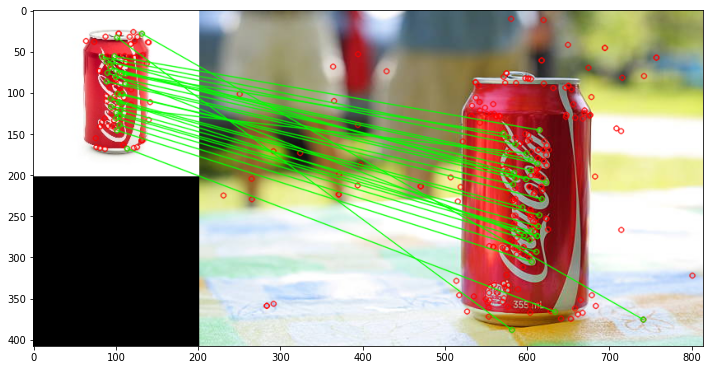

In [18]:
detect_keypoints2(coke, table, 10)

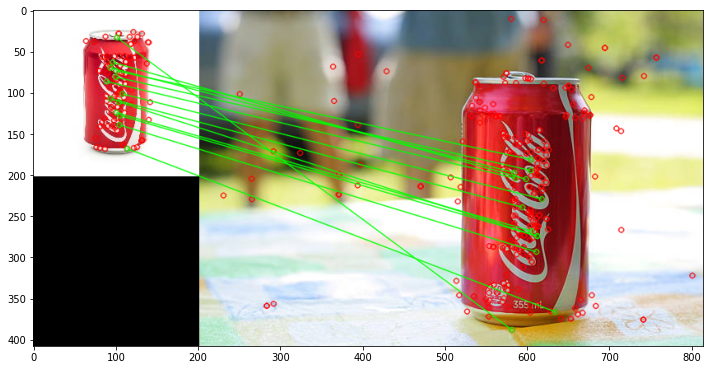

In [23]:
detect_keypoints2(coke, table, 15)
plt.savefig('zad1v2_2.png')

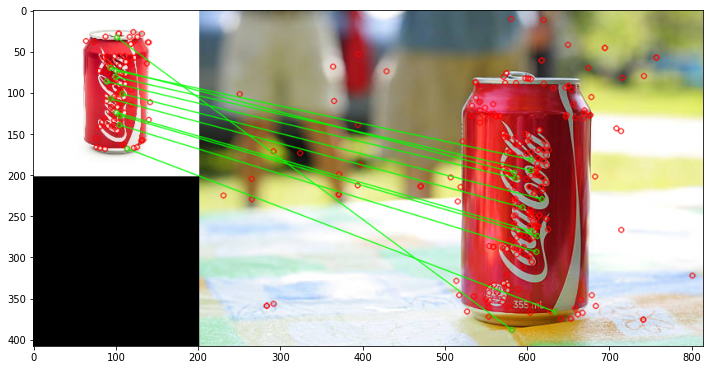

In [20]:
detect_keypoints2(coke, table, 20)

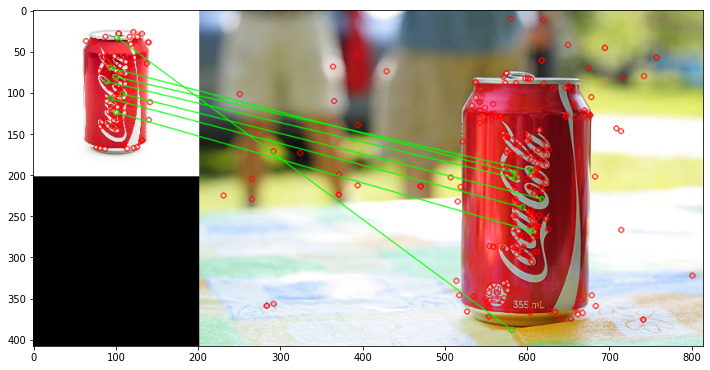

In [21]:
detect_keypoints2(coke, table, 50)

##### Zadanie 1c (0.5 pkt | 0.5 pkt)

Znajdź transformację geometryczną dla par dopasowanych punktów, tak aby przekształcić `coke` (*train*) do geometrii `table` (query). Zademonstruj poprawność, zestawiając obok siebie przekształconą wersję `coke` oraz oryginalny `table`, bądź nanosząc jedno na drugie. Zidentyfikuj punkty, które znaleziona transformacja przekształca "dobrze", tzn. ich współrzędne po przekształceniu leżą w pobliżu odpowiadających im punktów z drugiego obrazu; nanieś je na obraz.

*Jak na wyniki wpływa wykrycie większej lub mniejszej liczby punktów kluczowych na etapie SIFT? W jakim stopniu wstępna filtracja poprawia rezultaty?*

*Jeśli starczy czasu:* znajdź rejon zainteresowania (RoI), tj. prostokąt otaczający zidentyfikowane właśnie punkty, a następnie oblicz błąd średniokwadratowy między obrazami w tym rejonie (albo dowolną miarę podobieństwa). Bonus: użyj [`cv2.convexHull`](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#ga014b28e56cb8854c0de4a211cb2be656) do narysowania maski wybierającej tylko piksele znajdujące się wewnątrz wielokąta otaczającego "dobrze" dopasowane punkty, by liczyć miarę podobieństwa jedynie wewnątrz tego obszaru.

LEN OF ALL MATCHES:  111
LEN OF BEST MATCHES:  111
AFTER MASK:  25
(25, 2)
(25, 2)


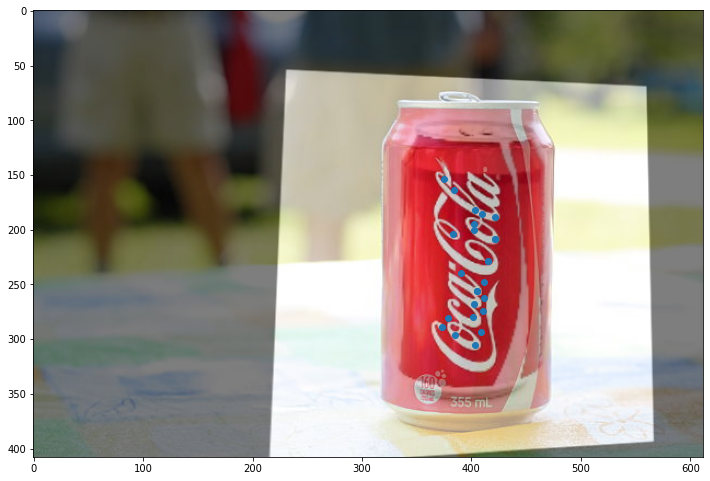

In [45]:
def geo_transform(img1, img2, dist_threshold=100, use_best=False, use_masking=True):
    sift = cv2.SIFT_create(contrastThreshold=0.05)
    kp1, ds1 = sift.detectAndCompute(img1, mask=None)
    kp2, ds2 = sift.detectAndCompute(img2, mask=None)

    matcher = cv2.BFMatcher_create()
    matches = matcher.match(ds1, ds2)
    
    
    if use_best:
        best_matches = []
        for match in matches:
            if match.distance <= dist_threshold:
                best_matches.append(match)
    else:
        best_matches = matches
        
    srcPoints = []
    distPoints = []
    
    for match in best_matches:
        srcPoints.append(kp1[match.queryIdx].pt)
        distPoints.append(kp2[match.trainIdx].pt)
    
    srcPoints = np.asarray(srcPoints)
    distPoints = np.asanyarray(distPoints)
    
    print('LEN OF ALL MATCHES: ',len(matches))
    print('LEN OF BEST MATCHES: ',len(best_matches))
    
    matrix, mask = cv2.findHomography(srcPoints, distPoints, method=cv2.RANSAC)
    print('AFTER MASK: ',mask.sum())
    firstSet = []
    secondSet = []
    
    for i, m in enumerate(mask):
        if use_masking:
            if m == 1:
                firstSet.append(srcPoints[i])
                secondSet.append(distPoints[i])
        else:
            firstSet.append(srcPoints[i])
            secondSet.append(distPoints[i])
            
    
    firstSet = np.asarray(firstSet)
    secondSet = np.asarray(secondSet)
    
    print(firstSet.shape)
    print(secondSet.shape)
    
    new_points = cv2.perspectiveTransform(firstSet.reshape(1,-1,2), matrix).reshape(-1, 2)
    
    warped = cv2.warpPerspective(img1, matrix, (img2.shape[1], img2.shape[0]))
    
    fig, ax = plt.subplots(1,1, figsize=(12,12))
    ax.imshow(warped[..., ::-1]);
    ax.imshow(img2[..., ::-1], alpha=0.5);
    ax.scatter(new_points[:,0], new_points[:,1])
#     plt.show()
    
geo_transform(coke, table, 900, True)

LEN OF ALL MATCHES:  111
LEN OF BEST MATCHES:  111
AFTER MASK:  25
(111, 2)
(111, 2)


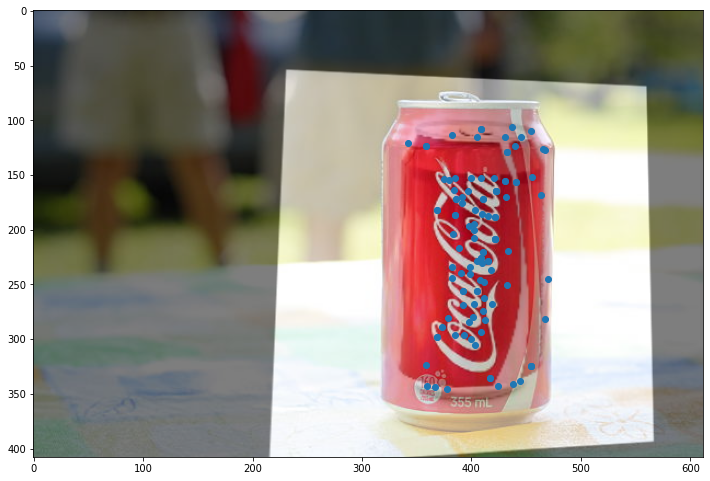

In [33]:
geo_transform(coke, table, 900, False)

LEN OF ALL MATCHES:  111
LEN OF BEST MATCHES:  111
AFTER MASK:  25
(111, 2)
(111, 2)


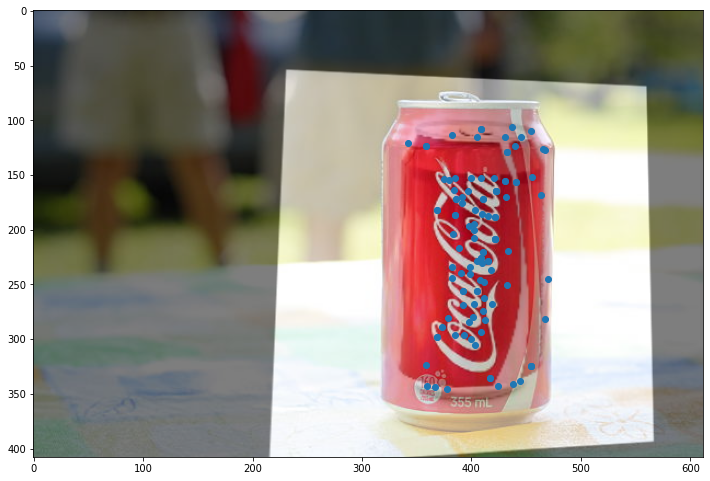

In [46]:
geo_transform(coke, table, 150, False, False)
plt.savefig('zad1v3_1.png')

LEN OF ALL MATCHES:  111
LEN OF BEST MATCHES:  4
AFTER MASK:  4
(4, 2)
(4, 2)


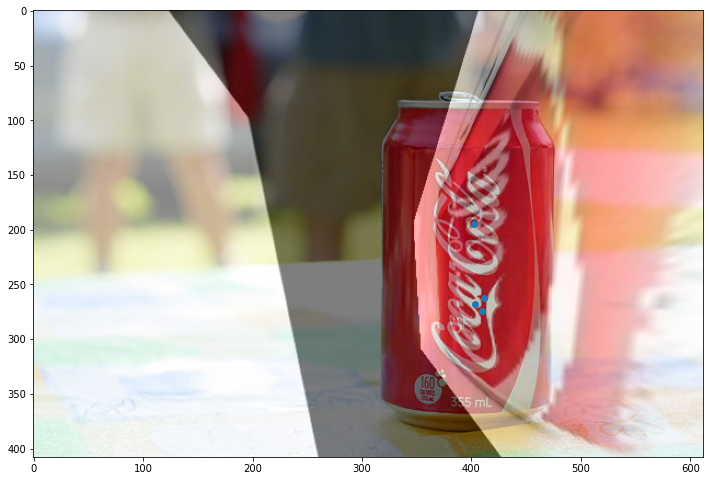

In [47]:
geo_transform(coke, table, 150, True, False)
plt.savefig('zad1v3_12.png')

LEN OF ALL MATCHES:  111
LEN OF BEST MATCHES:  55
AFTER MASK:  22
(22, 2)
(22, 2)


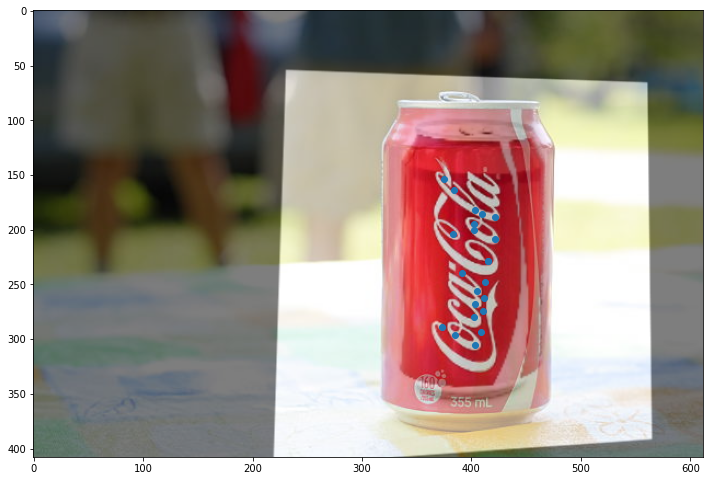

In [48]:
geo_transform(coke, table, 300, True)
plt.savefig('zad1v3_2.png')

LEN OF ALL MATCHES:  111
LEN OF BEST MATCHES:  55
AFTER MASK:  22
(55, 2)
(55, 2)


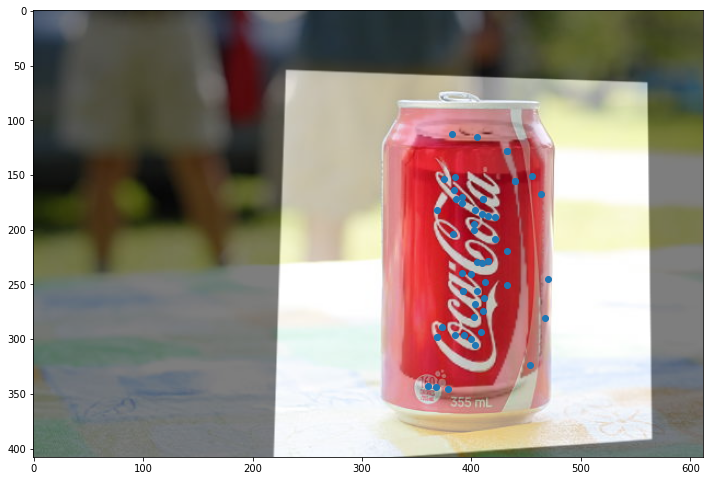

In [34]:
geo_transform(coke, table, 300, False)

#### Zadanie 2 (1 pkt | 1 pkt)

Powtórz eksperymenty dla obrazów `k7`, `detail` i `fine`, traktując `k7` jako *query* (tj. szukając weń wystąpień tamtych). **Co jest przyczyną trudności?**

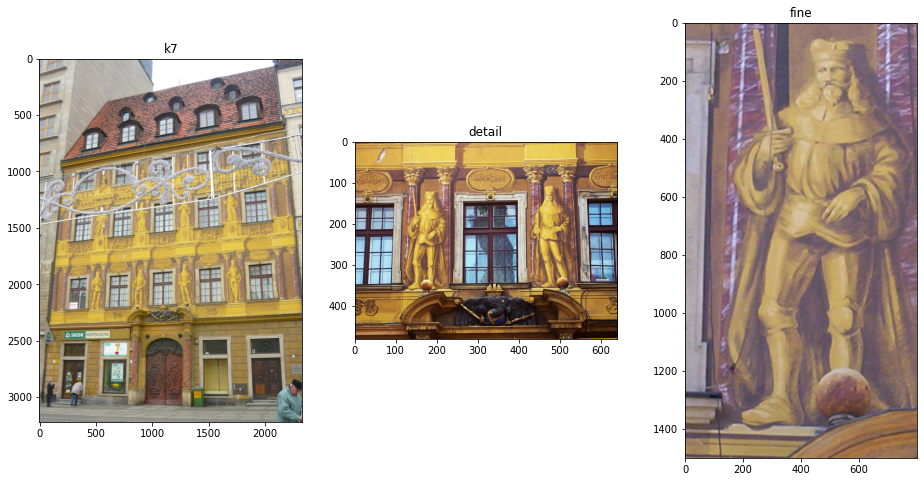

In [50]:
k7 = cv2.imread('kp7e.jpg')
detail = cv2.imread('kp7e_detail.jpg')
fine = cv2.imread('kp7e_fine.jpg')
f, (a1, a2, a3) = plt.subplots(1, 3, figsize=(16,8))
a1.imshow(k7[..., ::-1]);
a1.set_title('k7');
a2.imshow(detail[..., ::-1]);
a2.set_title('detail');
a3.imshow(fine[..., ::-1]);
a3.set_title('fine');
plt.savefig('zad2.png')

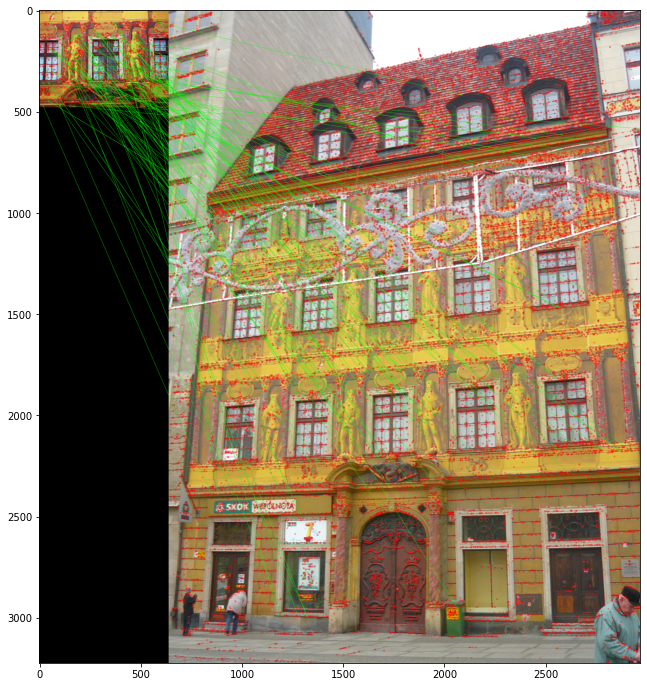

In [126]:
detect_keypoints(detail,k7, 100)

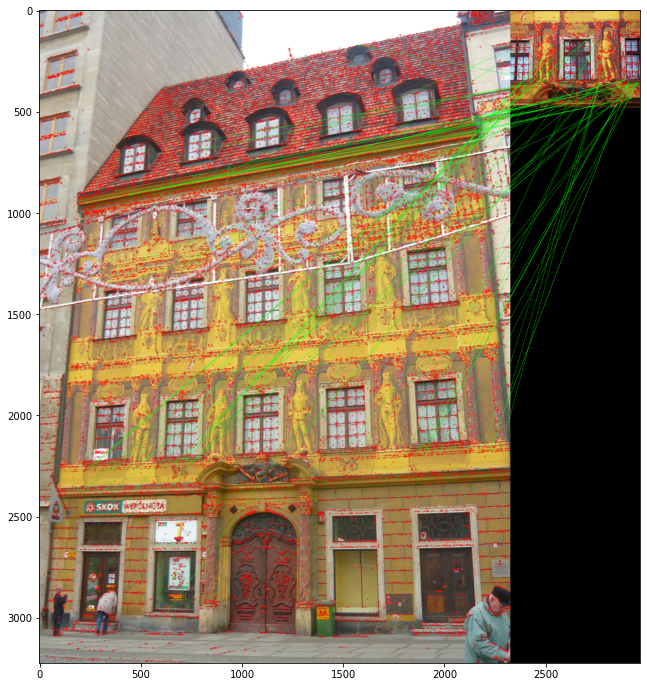

In [101]:
detect_keypoints(k7, detail, 70)

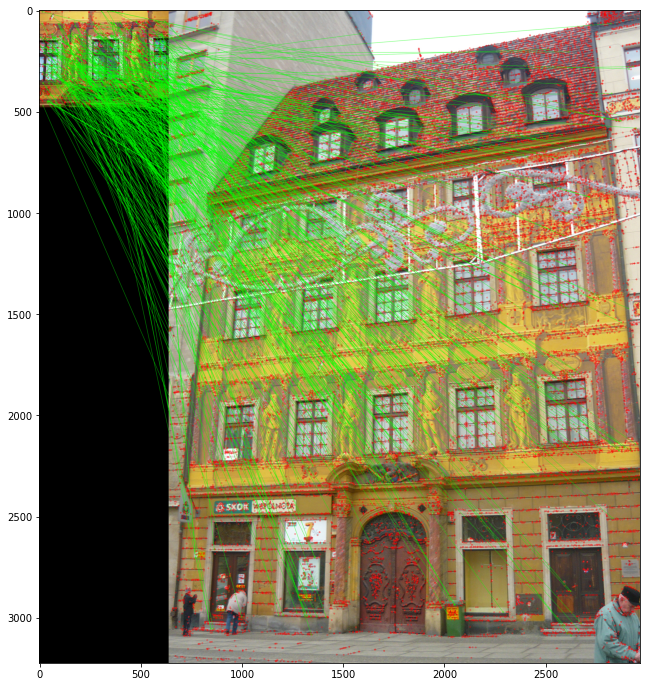

In [62]:
detect_keypoints(detail, k7, 150)

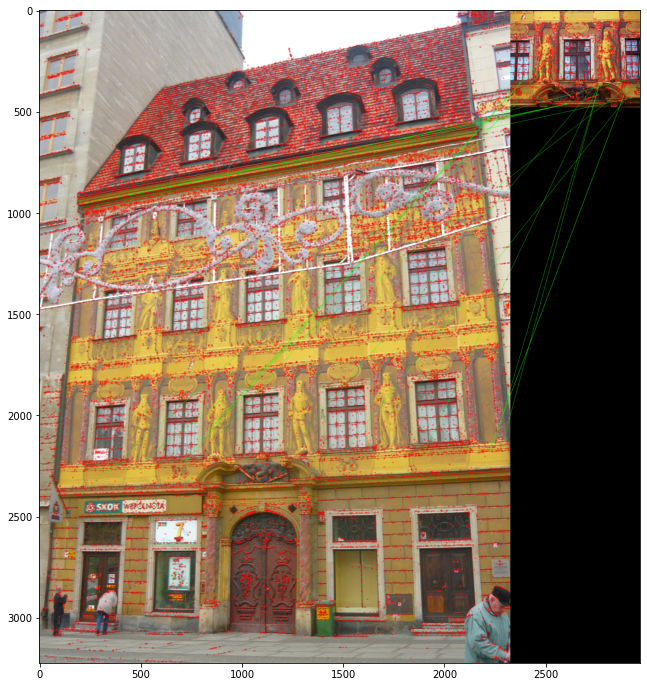

In [103]:
detect_keypoints(k7, detail, 60)

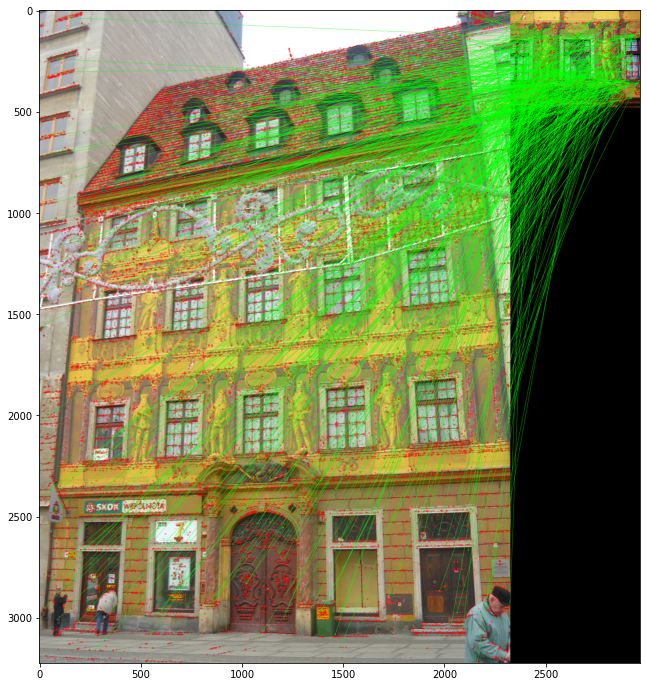

In [51]:
detect_keypoints2(k7, detail, 100)
plt.savefig('zad2_v1.png')

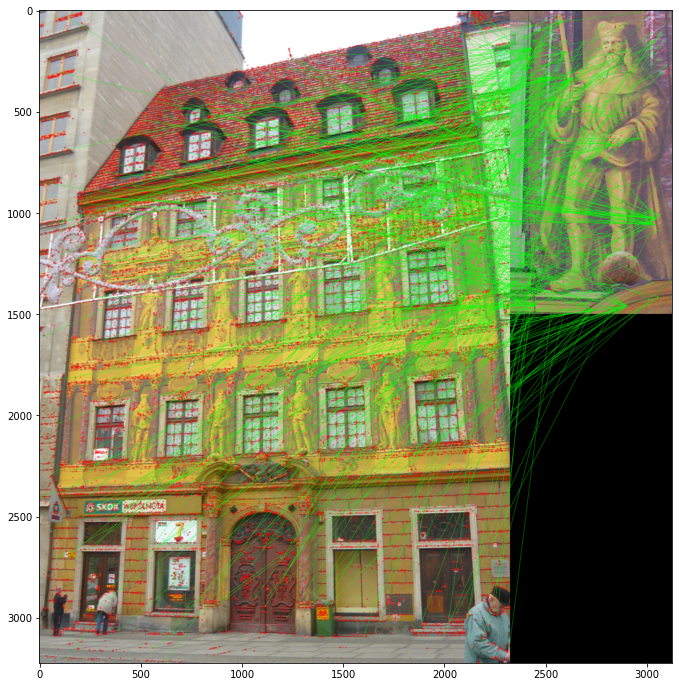

In [55]:
detect_keypoints2(k7, fine, 100)
plt.savefig('zad2v2.png')

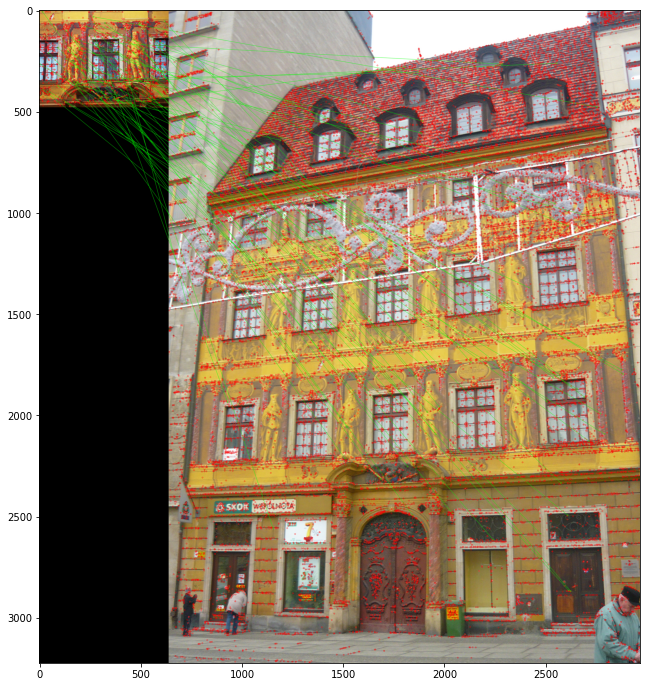

In [127]:
detect_keypoints2(detail,k7, 100)

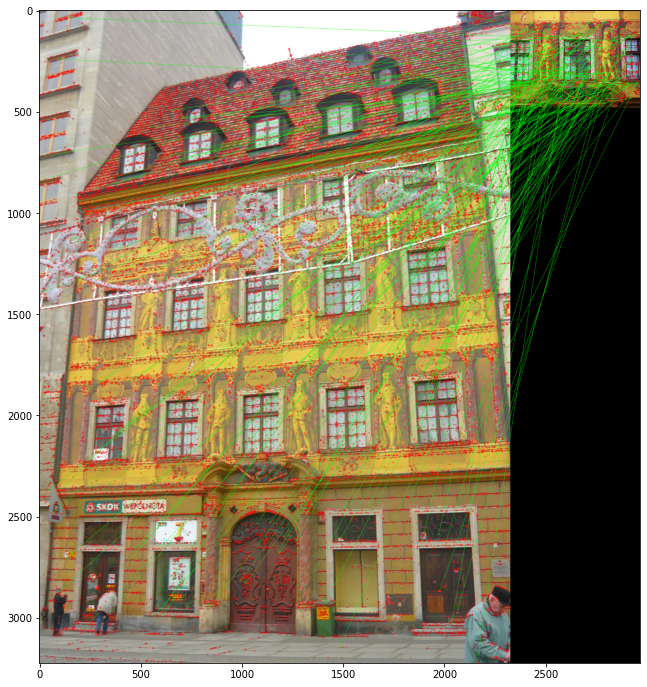

In [115]:
detect_keypoints2(k7, detail, 300)

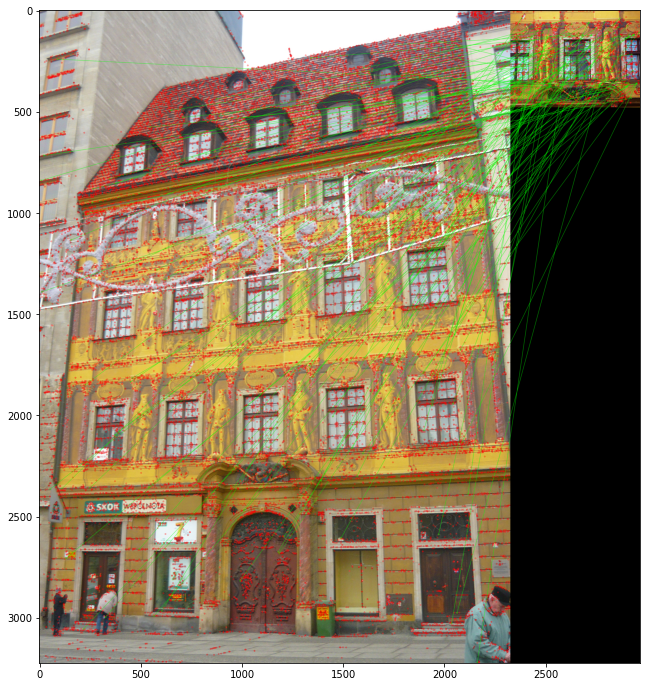

In [116]:
detect_keypoints2(k7, detail, 500)

LEN OF ALL MATCHES:  2427
LEN OF BEST MATCHES:  2427
AFTER MASK:  146
(146, 2)
(146, 2)


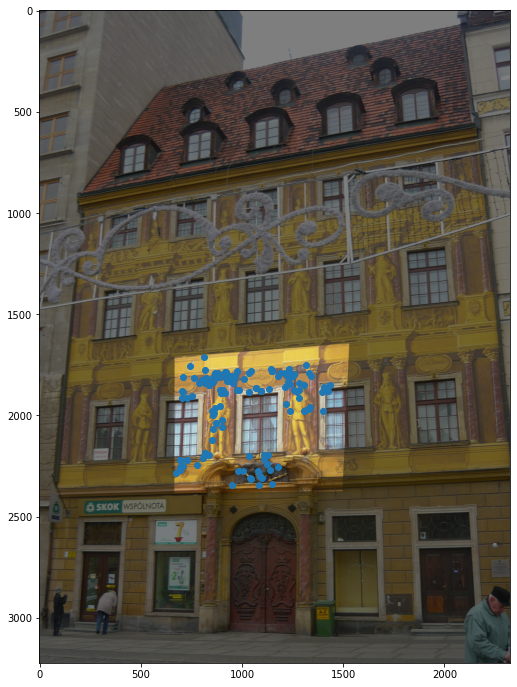

In [56]:
geo_transform(detail, k7, 300)
plt.savefig('zad2v31.png')

LEN OF ALL MATCHES:  33545
LEN OF BEST MATCHES:  33545
AFTER MASK:  521
(521, 2)
(521, 2)


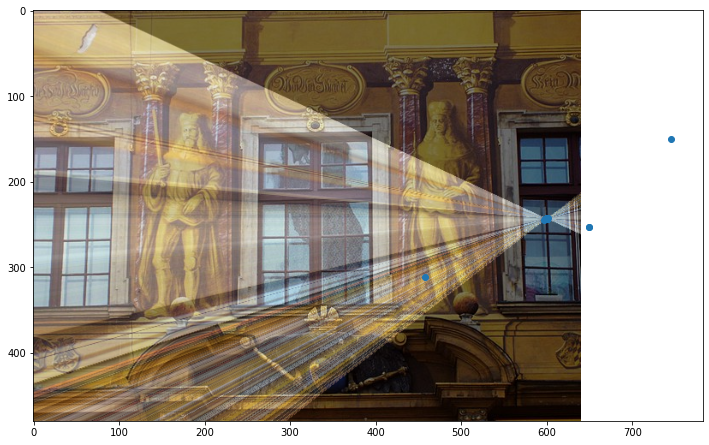

In [57]:
geo_transform(k7, detail, 300)
plt.savefig('zad2v32.png')

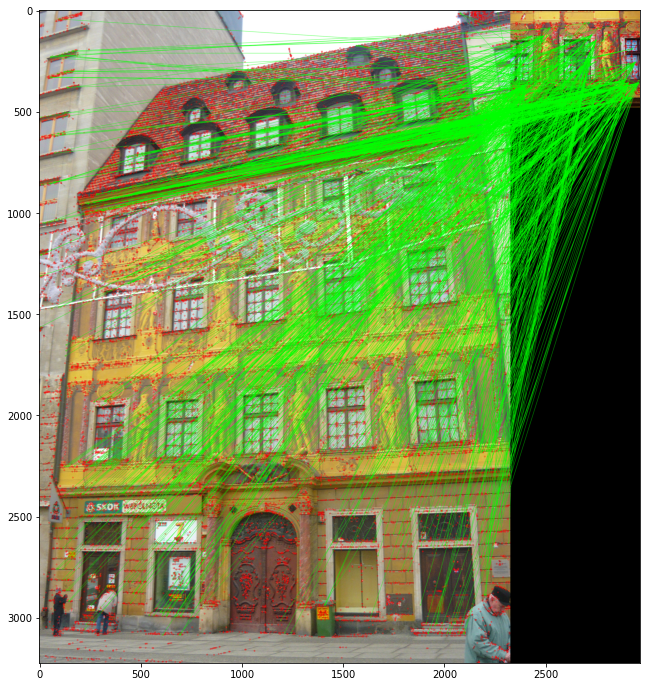

In [102]:
detect_keypoints(k7, detail, 100)

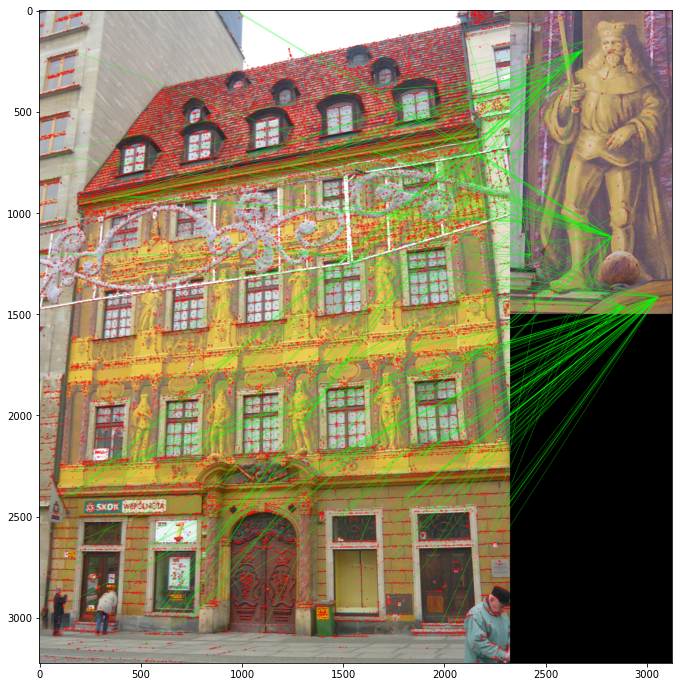

In [106]:
detect_keypoints(k7, fine, 100)

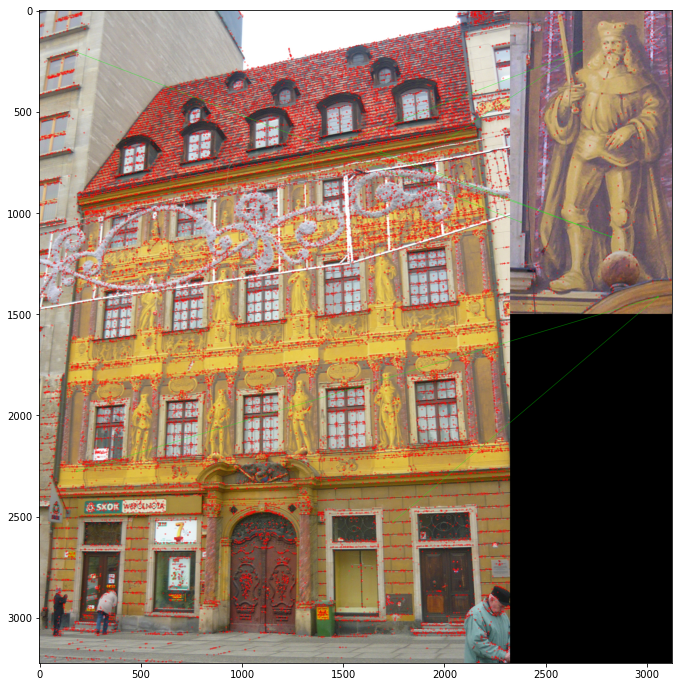

In [110]:
detect_keypoints(k7, fine, 80)

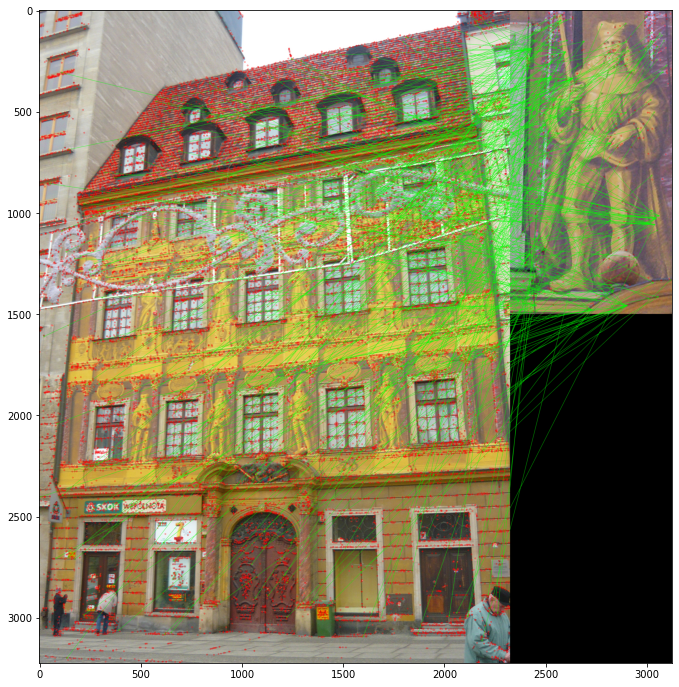

In [138]:
detect_keypoints2(k7, fine, 150)

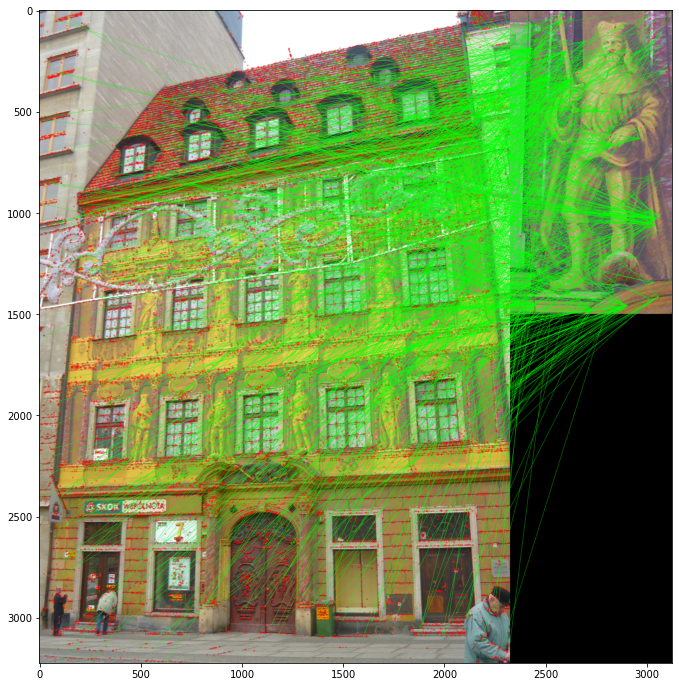

In [136]:
detect_keypoints2(k7, fine, 50)

LEN OF ALL MATCHES:  732
LEN OF BEST MATCHES:  732
AFTER MASK:  8
(8, 2)
(8, 2)


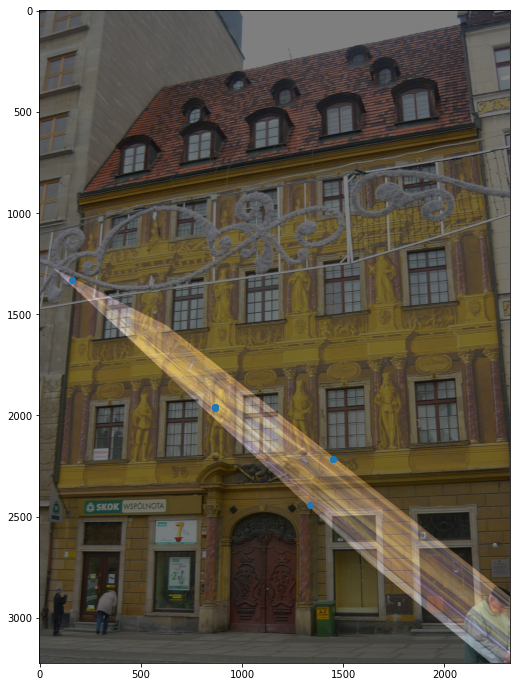

In [59]:
geo_transform(fine, k7, 900)

LEN OF ALL MATCHES:  33545
LEN OF BEST MATCHES:  33545
AFTER MASK:  905
(905, 2)
(905, 2)


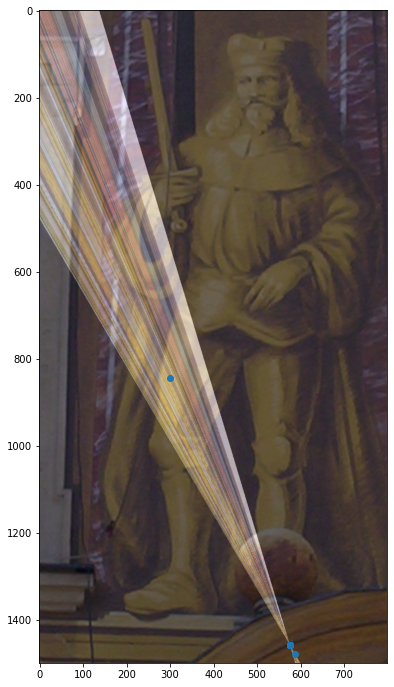

In [60]:
geo_transform(k7, fine, 900)

*Jeśli starczy czasu*: uwzględnij również obraz `side`.

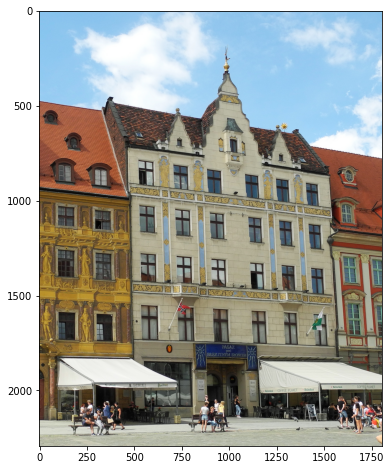

In [4]:
side = cv2.imread('kp7e_side.jpg')
plt.subplots(1, 1, figsize=(8,8))[1].imshow(side[..., ::-1]);